# Importing libraries and loading data

In [29]:
import sys

import folium
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from folium import plugins

from my_secrets import MAPBOX_TOKEN

print("Python       :", sys.version.split("\n")[0])
print("Pandas       :", pd.__version__)

Python       : 3.10.0 (tags/v3.10.0:b494f59, Oct  4 2021, 19:00:18) [MSC v.1929 64 bit (AMD64)]
Pandas       : 1.4.3


In [30]:
data = pd.read_csv("data/fires_in_australia.csv")
sample_data = data.iloc[np.random.choice(data.index, 1000)]

data.head()

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight
0,-14.281,143.636,323.9,1.7,1.3,2019-10-01,25,Terra,MODIS,70,6.0NRT,302.3,26.8,D
1,-14.284,143.532,343.5,1.7,1.3,2019-10-01,25,Terra,MODIS,90,6.0NRT,306.3,84.3,D
2,-14.302,143.706,320.2,1.7,1.3,2019-10-01,25,Terra,MODIS,30,6.0NRT,305.0,14.1,D
3,-14.283,143.652,320.4,1.7,1.3,2019-10-01,25,Terra,MODIS,57,6.0NRT,303.3,18.4,D
4,-14.285,143.521,349.4,1.7,1.3,2019-10-01,25,Terra,MODIS,94,6.0NRT,304.7,110.7,D


In [31]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183593 entries, 0 to 183592
Data columns (total 14 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   latitude    183593 non-null  float64
 1   longitude   183593 non-null  float64
 2   brightness  183593 non-null  float64
 3   scan        183593 non-null  float64
 4   track       183593 non-null  float64
 5   acq_date    183593 non-null  object 
 6   acq_time    183593 non-null  int64  
 7   satellite   183593 non-null  object 
 8   instrument  183593 non-null  object 
 9   confidence  183593 non-null  int64  
 10  version     183593 non-null  object 
 11  bright_t31  183593 non-null  float64
 12  frp         183593 non-null  float64
 13  daynight    183593 non-null  object 
dtypes: float64(7), int64(2), object(5)
memory usage: 19.6+ MB


# 1 Folium
**Folium makes it easy to visualize data that’s been manipulated in Python on an interactive leaflet map.** 

**It enables both the binding of data to a map for choropleth visualizations as well as passing rich vector/raster/HTML visualizations as markers on the map.**

<img src="folium2.png" alt="drawing" width="600"/>

[fsdfd](./folium.png)

In [32]:
!ls

README.md
__pycache__
australian-fires-density-heatmap-animated-map.ipynb
data
my_secrets.py


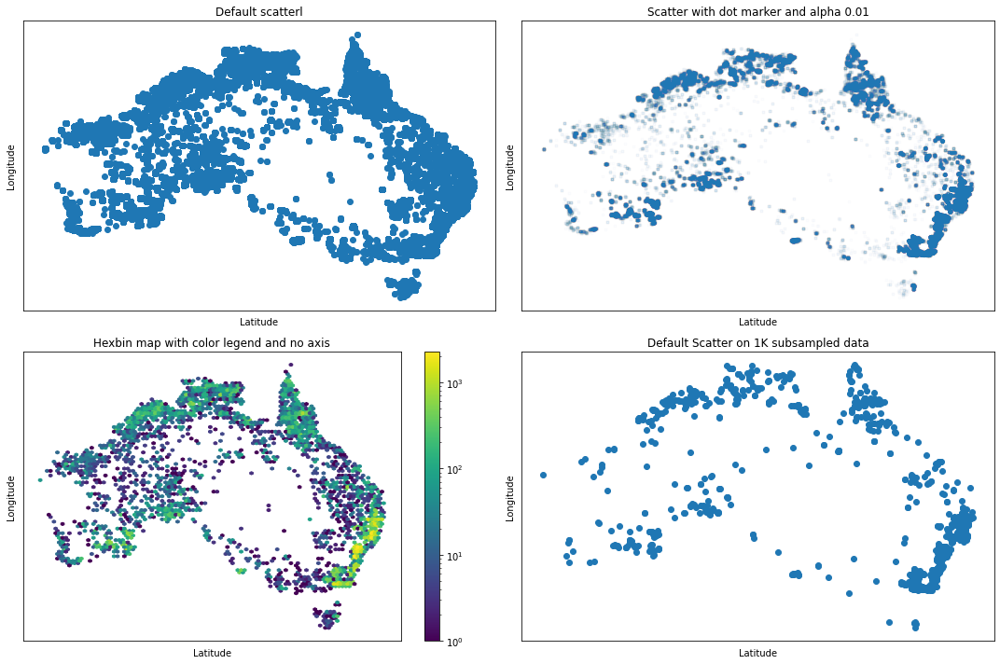

In [33]:
fig, axes = plt.subplots(
    2, 2, figsize=(15, 10), subplot_kw={"xticks": (), "yticks": ()}
)
axes[0, 0].scatter(data.longitude, data.latitude)
axes[0, 0].set_title("Default scatterl")
axes[0, 1].scatter(data.longitude, data.latitude, alpha=0.01, marker=".")
axes[0, 1].set_title("Scatter with dot marker and alpha 0.01")
img = axes[1, 0].hexbin(data.longitude, data.latitude, bins="log")
axes[1, 0].set_title("Hexbin map with color legend and no axis")
axes[1, 1].scatter(sample_data.longitude, sample_data.latitude)
axes[1, 1].set_title("Default Scatter on 1K subsampled data")
for ax in axes.ravel():
    ax.set_xlabel("Latitude")
    ax.set_ylabel("Longitude")
plt.tight_layout()
fig.colorbar(img, ax=axes[1, 0])
plt.show()



The data shows the locations(lat long) and density(number of cases) of the australia bushfires as seen from satellite images

Lets look at the sample data when plotted on the Australia Map

Данные показывают местоположение (широта) и плотность (количество случаев) лесных пожаров в Австралии, как видно из спутниковых снимков

Давайте посмотрим на примерные данные, нанесенные на карту Австралии

In [34]:
# Create a map
f = folium.Figure(width=800, height=500)
center_lat = -24.003249
center_long = 133.737310
map = folium.Map(
    location=[center_lat, center_long],
    control_scale=True,
    zoom_start=4,
    width=800,
    height=500,
    zoom_control=True,
    tiles="Stamen Terrain",
).add_to(f)
for i in range(0, sample_data.shape[0]):
    location = [sample_data.iloc[i]["latitude"], sample_data.iloc[i]["longitude"]]
    folium.CircleMarker(location, radius=1, color="#FF4500").add_to(map)
map

# 2 Plotly
**Plotly's Python graphing library makes interactive, publication-quality graphs.**

<img src="plotly.png" alt="drawing" width="600"/>

In [35]:
# Density Mapbox with plotly.graph_objects

fig = go.Figure(
    go.Densitymapbox(
        lat=data.latitude,
        lon=data.longitude,
        z=data.brightness,
        radius=5,
        colorscale="Reds",
    )
)

fig.update_layout(
    mapbox_style="stamen-terrain",
    mapbox_center_lon=134,
    mapbox_center_lat=-25,
    mapbox_zoom=2.4,
    width=800,
    height=600,
)

fig.update_layout(
    title="Australian Fires", title_font=dict(size=30, color="FireBrick"), title_x=0.5
)

fig.show()

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

In [ ]:
# Density Animated Mapbox with plotly.express
data_sort = data.sort_values(by=["acq_date"], ascending=True)

fig = px.density_mapbox(
    data_sort,
    lon="longitude",
    lat="latitude",
    z="brightness",
    radius=8,
    center=dict(lon=134, lat=-25),
    zoom=2.4,
    mapbox_style="carto-positron",
    color_continuous_scale="reds",
    animation_frame="acq_date",
    labels={"acq_date": "Date"},
)

fig.update_layout(
    title="Australian Fires: From 2019/10/01 to 2020/01/11",
    title_font=dict(size=18, color="FireBrick"),
    title_x=0.5,
    width=800,
    height=600,
)

fig.show()

# 3 Mapbox
**Mapbox is a location data platform that powers the maps and location services used in many popular apps.**

<img src="mapbox.png" alt="drawing" width="600"/>

In [ ]:
times = data.groupby(["acq_date"])["acq_date"].count().index.tolist()
frames_data = [data.loc[data["acq_date"] == t] for t in times]

NameError: name 'data' is not defined

In [ ]:
frames = [
    go.Frame(
        data=[
            go.Densitymapbox(
                lat=f["latitude"], lon=f["longitude"], z=f["brightness"], radius=10
            )
        ],
        name=str(f.iloc[0]["acq_date"]),
    )
    for f in frames_data
]

In [ ]:
buttons = [
    dict(
        label="Play",
        method="animate",
        args=[
            None,
            {
                "fromcurrent": True,
                "transition": {"duration": 30, "easing": "quadratic-in-out"},
            },
        ],
    ),
    dict(
        label="Pause",
        method="animate",
        args=[
            [None],
            {
                "frame": {"duration": 0, "redraw": False},
                "mode": "immediate",
                "transition": {"duration": 0},
            },
        ],
    ),
]


sliders_dict = {
    "active": 0,
    "currentvalue": dict(font=dict(size=16), prefix="Time: ", visible=True),
    "transition": {"duration": 300, "easing": "cubic-in-out"},
    "x": 0,
    "steps": [],
}

for i, t in enumerate(times):
    slider_step = {
        "args": [
            [t],
            {
                "frame": {"duration": 300, "redraw": False},
                # "mode": "immediate",
                "transition": {"duration": 30, "easing": "quadratic-in-out"},
            },
        ],
        "label": t,
        "method": "animate",
        "value": t,
    }
    sliders_dict["steps"].append(slider_step)

NameError: name 'times' is not defined

In [ ]:
from my_secrets import MAPBOX_TOKEN

MAPBOX_STYLE = "satellite-streets"

In [ ]:
fig = go.Figure(
    data=[
        go.Densitymapbox(
            lat=data["latitude"],
            lon=data["longitude"],
            z=data["brightness"],
            radius=1,
            colorscale="Hot",
            zmax=400,
            zmin=0,
        )
    ],
    layout=go.Layout(
        updatemenus=[dict(type="buttons", buttons=buttons, showactive=True)]
    ),
    frames=frames,
)

fig.update_layout(
    mapbox_style=MAPBOX_STYLE,
    mapbox_accesstoken=MAPBOX_TOKEN,
    mapbox_center_lon=135,
    mapbox_center_lat=-25.34,
    mapbox_zoom=3.5,
    width=1000,
    height=600,
)


fig.update_layout(sliders=[sliders_dict], title="Australia fires over time")

fig.update_layout(height=850)
fig.show()